In [1]:
using Plots
plotlyjs()

WebIO._IJuliaInit()

Plots.PlotlyJSBackend()

In [2]:
using Images

In [3]:
using FileIO

In [4]:
using DelimitedFiles

In [5]:
function depth_to_dist(dimg)
    return reshape([Int(dimg[k].val.i)/1000.0 for k in eachindex(dimg)], size(dimg))
end
function dist_to_pc(dimg, KKinv)
    
    N = length(dimg)
    
    UVZ = ones(4, N)
    
    for (i, p) in enumerate(CartesianIndices(dimg))
        z = dimg[p]
        
        UVZ[1,i] = z * p[2]
        UVZ[2,i] = z * p[1]
        UVZ[3,i] = z
    end
    
    PC = KKinv * UVZ
        
    return PC
end

dist_to_pc (generic function with 1 method)

In [6]:
#data_folder = joinpath(pwd(), "data/sun3d-harvard_c11-hv_c11_2")
data_folder = joinpath(pwd(), "data/analysis-by-synthesis-apt1-kitchen")
data_folder = joinpath(pwd(), "data/bundlefusion-copyroom")

"/Users/devanshagrawal/research/7_2022_fall/point_cloud_registration/data/bundlefusion-copyroom"

In [7]:
camera_intrinsics = readdlm(joinpath(data_folder,"camera-intrinsics.txt"))

3×3 Matrix{Float64}:
 583.0    0.0  320.0
   0.0  583.0  240.0
   0.0    0.0    1.0

In [8]:
KK = [[camera_intrinsics ;; zeros(3,1)] ; [zeros(1,3);; 1]]

4×4 Matrix{Float64}:
 583.0    0.0  320.0  0.0
   0.0  583.0  240.0  0.0
   0.0    0.0    1.0  0.0
   0.0    0.0    0.0  1.0

In [9]:
KKinv = inv(KK)

4×4 Matrix{Float64}:
 0.00171527  0.0         -0.548885  0.0
 0.0         0.00171527  -0.411664  0.0
 0.0         0.0          1.0       0.0
 0.0         0.0          0.0       1.0

In [10]:
img_nums = [lpad(i, 6, '0') for i in 0:5:25]
#color_img_paths = [joinpath(data_folder, "seq-01/frame-$(n).color.png") for n in img_nums]
depth_img_paths = [joinpath(data_folder, "seq-01/frame-$(n).depth.png") for n in img_nums]
true_rota_paths = [joinpath(data_folder, "seq-01/frame-$(n).pose.txt") for n in img_nums]

6-element Vector{String}:
 "/Users/devanshagrawal/research/" ⋯ 61 bytes ⋯ "om/seq-01/frame-000000.pose.txt"
 "/Users/devanshagrawal/research/" ⋯ 61 bytes ⋯ "om/seq-01/frame-000005.pose.txt"
 "/Users/devanshagrawal/research/" ⋯ 61 bytes ⋯ "om/seq-01/frame-000010.pose.txt"
 "/Users/devanshagrawal/research/" ⋯ 61 bytes ⋯ "om/seq-01/frame-000015.pose.txt"
 "/Users/devanshagrawal/research/" ⋯ 61 bytes ⋯ "om/seq-01/frame-000020.pose.txt"
 "/Users/devanshagrawal/research/" ⋯ 61 bytes ⋯ "om/seq-01/frame-000025.pose.txt"

In [11]:
#color_imgs = [load(p) for p in color_img_paths]

,,,,,

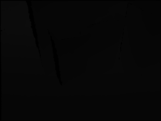
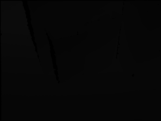
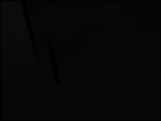
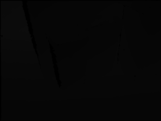
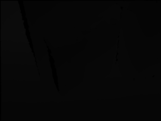
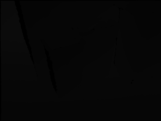

In [12]:
depth_imgs = [load(p) for p in depth_img_paths]

In [13]:
true_rots = [readdlm(p) for p in true_rota_paths]

6-element Vector{Matrix{Float64}}:
 [1.0 0.0 0.0 0.0; 0.0 1.0 0.0 0.0; 0.0 0.0 1.0 0.0; 0.0 0.0 0.0 1.0]
 [0.999612 -0.0246779 0.0129312 0.00345359; 0.0246024 0.99968 0.00596469 0.00665868; -0.0130742 -0.00564426 0.999899 -0.00543849; 0.0 0.0 0.0 1.0]
 [0.999618 -0.0253512 0.010997 0.0148266; 0.0256309 0.999331 -0.0260865 0.0149949; -0.0103283 0.0263584 0.999599 -0.00587501; 0.0 0.0 0.0 1.0]
 [0.999472 -0.0318222 0.00652442 0.00552076; 0.032001 0.999055 -0.0294158 0.0065971; -0.0055822 0.029609 0.999546 0.00163119; 0.0 0.0 0.0 1.0]
 [0.99881 -0.0444161 0.0201535 0.00238087; 0.0451188 0.998338 -0.0358617 -0.0138297; -0.0185271 0.0367283 0.999153 0.0159942; 0.0 0.0 0.0 1.0]
 [0.998392 -0.0473092 0.031227 0.00711544; 0.0484581 0.998135 -0.0371225 -0.0242291; -0.0294124 0.038576 0.998823 0.0275595; 0.0 0.0 0.0 1.0]

In [14]:
dist_imgs = [depth_to_dist(d) for d in depth_imgs]

6-element Vector{Matrix{Float64}}:
 [0.0 0.0 … 1.245 1.245; 0.0 2.706 … 1.25 1.25; … ; 0.0 0.0 … 1.429 1.429; 0.0 0.0 … 1.429 1.429]
 [0.0 0.0 … 1.25 1.25; 0.0 2.731 … 1.25 1.25; … ; 0.0 0.0 … 1.416 1.416; 0.0 0.0 … 1.416 1.416]
 [0.0 0.0 … 0.0 0.0; 0.0 2.706 … 1.266 1.266; … ; 0.0 0.0 … 1.436 1.436; 0.0 0.0 … 1.436 1.436]
 [0.0 0.0 … 1.25 1.25; 0.0 2.682 … 1.25 1.25; … ; 0.0 0.0 … 1.436 1.436; 0.0 0.0 … 1.436 1.436]
 [0.0 0.0 … 1.272 1.272; 0.0 2.682 … 1.272 1.272; … ; 0.0 0.0 … 1.45 1.45; 0.0 0.0 … 1.45 1.45]
 [0.0 0.0 … 1.261 1.261; 0.0 2.658 … 1.261 1.261; … ; 0.0 0.0 … 1.45 1.45; 0.0 0.0 … 1.45 1.45]

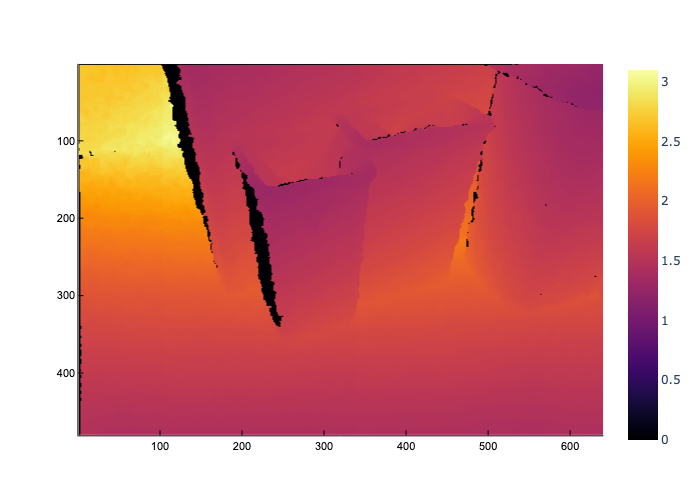

In [15]:
heatmap(dist_imgs[1], yflip=true)

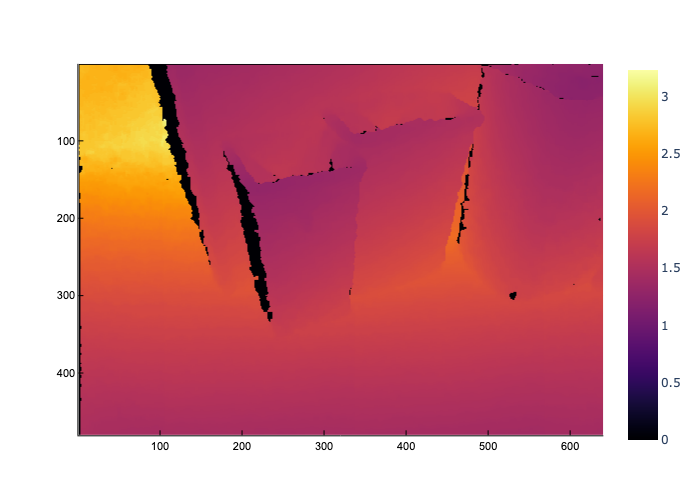

In [24]:
heatmap(dist_imgs[2], yflip=true)

In [17]:
pcs = [dist_to_pc(d, KKinv) for d in dist_imgs]

6-element Vector{Matrix{Float64}}:
 [0.0 0.0 … 0.7843567753001716 0.7843567753001716; 0.0 0.0 … 0.5858164665523155 0.5882675814751287; 0.0 0.0 … 1.429 1.429; 1.0 1.0 … 1.0 1.0]
 [0.0 0.0 … 0.777221269296741 0.777221269296741; 0.0 0.0 … 0.5804871355060035 0.5829159519725557; 0.0 0.0 … 1.416 1.416; 1.0 1.0 … 1.0 1.0]
 [0.0 0.0 … 0.7881989708404801 0.7881989708404801; 0.0 0.0 … 0.5886861063464836 0.5911492281303602; 0.0 0.0 … 1.436 1.436; 1.0 1.0 … 1.0 1.0]
 [0.0 0.0 … 0.7881989708404801 0.7881989708404801; 0.0 0.0 … 0.5886861063464836 0.5911492281303602; 0.0 0.0 … 1.436 1.436; 1.0 1.0 … 1.0 1.0]
 [0.0 0.0 … 0.7958833619210978 0.7958833619210978; 0.0 0.0 … 0.5944253859348199 0.5969125214408233; 0.0 0.0 … 1.45 1.45; 1.0 1.0 … 1.0 1.0]
 [0.0 0.0 … 0.7958833619210978 0.7958833619210978; 0.0 0.0 … 0.5944253859348199 0.5969125214408233; 0.0 0.0 … 1.45 1.45; 1.0 1.0 … 1.0 1.0]

In [18]:
pcs_world = [true_rots[i] * pcs[i] for i in 1:length(pcs)]

6-element Vector{Matrix{Float64}}:
 [0.0 0.0 … 0.7843567753001716 0.7843567753001716; 0.0 0.0 … 0.5858164665523155 0.5882675814751287; 0.0 0.0 … 1.429 1.429; 1.0 1.0 … 1.0 1.0]
 [0.00345359 0.00345359 … 0.7843586731629502 0.7842987350730702; 0.00665868 0.00665868 … 0.6145275692183878 0.6169556084636707; -0.00543849 -0.00543849 … 1.3969805273615095 1.3969668184898798; 1.0 1.0 … 1.0 1.0]
 [0.0148266 0.0148266 … 0.803592271614408 0.8035298285214406; 0.0149949 0.0149949 … 0.586029210343053 0.5884906842984563; -0.00587501 -0.00587501 … 1.4369252224349913 1.4369901463842194; 1.0 1.0 … 1.0 1.0]
 [0.00552076 0.00552076 … 0.7839393418904972 0.7838609599364663; 0.0065971 0.0065971 … 0.5777089644418524 0.5801697585756432; 0.00163119 0.00163119 … 1.4500097686277873 1.450082699200686; 1.0 1.0 … 1.0 1.0]
 [0.00238087 0.00238087 … 0.8001376483361922 0.800027179476844; -0.0138297 -0.0138297 … 0.5635175881732417 0.5660005900600342; 0.0159942 0.0159942 … 1.4718528732675813 1.4719442215265865; 1.0 1.0 … 

In [19]:
randinds = rand(1:size(pcs[1],2), 5000);

In [20]:
size(pcs[1],2)

307200

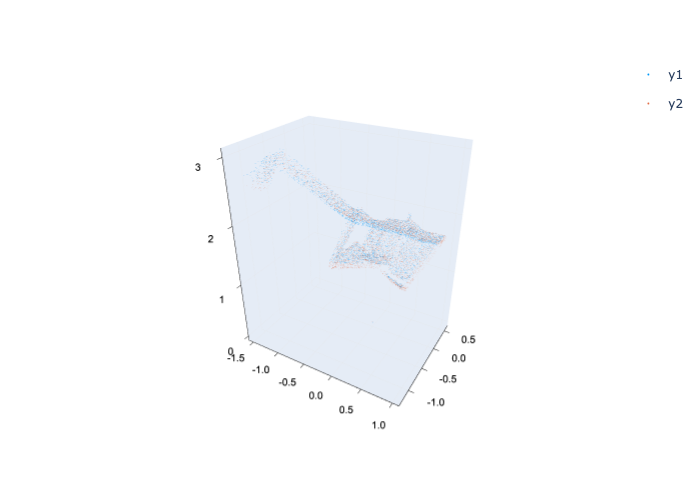

In [21]:
plot()
ind = 1
scatter!(pcs_world[ind][1, randinds], pcs_world[ind][2, randinds], pcs_world[ind][3, randinds]; markersize=0.1, markerstrokewidth=0)
ind = 6
scatter!(pcs_world[ind][1, randinds], pcs_world[ind][2, randinds], pcs_world[ind][3, randinds]; markersize=0.1, markerstrokewidth=0)
# scatter!(pcs_world[6][1, randinds], pcs_world[6][2, randinds], pcs_world[6][3, randinds]; markersize=0.1, markerstrokewidth=0)

In [22]:
true_rots[1]

4×4 Matrix{Float64}:
 1.0  0.0  0.0  0.0
 0.0  1.0  0.0  0.0
 0.0  0.0  1.0  0.0
 0.0  0.0  0.0  1.0

In [23]:
true_rots[6]

4×4 Matrix{Float64}:
  0.998392   -0.0473092   0.031227    0.00711544
  0.0484581   0.998135   -0.0371225  -0.0242291
 -0.0294124   0.038576    0.998823    0.0275595
  0.0         0.0         0.0         1.0